In [19]:
import pandas as pd

def concatenate_csv_files(file1, file2, output_file):
    df1 = pd.read_csv(file1)
    df2 = pd.read_csv(file2)
    
    df2.rename(columns={"id_gta_origem_outro_estado": "id_gta"}, inplace=True)
    concatenated_df = pd.concat([df1, df2], ignore_index=True)
    concatenated_df.to_csv(output_file, index=False, sep=";")
    print(f"Planilhas concatenadas com sucesso! Salvo em {output_file}")

file1 = "bd/bd_gta_estado_MG_202501311609.csv"
file2 = "bd/bd_gta_origem_outro_estado_202501311605.csv"
output_file = "bd/dados_combinados.csv"

concatenate_csv_files(file1, file2, output_file)


Planilhas concatenadas com sucesso! Salvo em bd/dados_combinados.csv


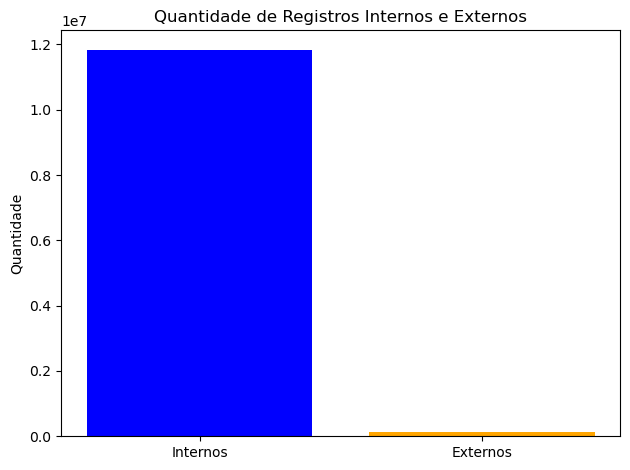

count    1.197154e+07
mean     1.275443e+01
std      1.746215e+01
min      1.000000e+00
25%      2.000000e+00
50%      6.000000e+00
75%      1.600000e+01
max      1.500000e+02
Name: qt_animais, dtype: float64
Número de registros únicos em id_gta: 8357912
Número de registros únicos em id_gta dentro do estado: 8310419
                   coluna  valores_nulos
0                  id_gta              0
1          dt_emissao_gta              0
2      id_produtor_origem          28376
3     id_produtor_destino              0
4  id_tipo_finalidade_gta              0
5        municipio_origem              0
6           estado_origem              0
7       municipio_destino              0
8          estado_destino              0
9              qt_animais              0
                   coluna  valores_nulos
0                  id_gta              0
1          dt_emissao_gta              0
2      id_produtor_origem          28376
3     id_produtor_destino              0
4  id_tipo_finalidade_gta 

In [10]:
import pandas as pd
import os
import matplotlib.pyplot as plt

def process_and_analyze_data(unified_file, output_folder,file1):
    combined_df = pd.read_csv(unified_file)
    df1 = pd.read_csv(file1)

    if not os.path.exists(output_folder):
        os.makedirs(output_folder)

    registros_internos = combined_df[combined_df["estado_origem"] == combined_df["estado_destino"]]
    registros_externos = combined_df[combined_df["estado_origem"] != combined_df["estado_destino"]]

    plt.bar(["Internos", "Externos"], [len(registros_internos), len(registros_externos)], color=["blue", "orange"])
    plt.title("Quantidade de Registros Internos e Externos")
    plt.ylabel("Quantidade")
    plt.tight_layout()
    plt.savefig(f"{output_folder}/histograma_internos_vs_externos.png")
    plt.show()

    print(combined_df["qt_animais"].describe())

    unique_gta_count = combined_df["id_gta"].nunique()
    print(f"Número de registros únicos em id_gta: {unique_gta_count}")

    unified_gta_count_df1 = df1["id_gta"].nunique()
    print(f"Número de registros únicos em id_gta dentro do estado: {unified_gta_count_df1}")

    null_counts = combined_df.isnull().sum().reset_index()
    null_counts.columns = ["coluna", "valores_nulos"]
    print(null_counts)
    null_counts.to_csv(f"{output_folder}/valores_nulos_por_coluna.csv", index=True, sep=";")

    null_counts_df1 = df1.isnull().sum().reset_index()
    null_counts_df1.columns = ["coluna", "valores_nulos"]
    print(null_counts_df1)

    gerar_tabela_por_produtor(unified_file, output_folder)

def gerar_tabela_por_produtor(unified_file, output_folder):
    combined_df = pd.read_csv(unified_file)
    combined_df["id_produtor_destino"] = combined_df["id_produtor_destino"].astype(str)

    registros_por_produtor = combined_df["id_produtor_destino"].value_counts().reset_index()
    registros_por_produtor.columns = ["id_produtor_destino", "quantidade_registros"]

    output_file = f"{output_folder}/tabela_registros_por_produtor.csv"
    registros_por_produtor.to_csv(output_file, index=True, sep=";")

file = "bd/dados_combinados.csv"
file1 = "bd/bd_gta_estado_MG_202501311609.csv"
output_folder = "bd/dados_por_produtor"
process_and_analyze_data(file, output_folder, file1)


In [1]:
import pandas as pd

def analyze_different_destinations(file1, file2):
    df1 = pd.read_csv(file1)
    df2 = pd.read_csv(file2)

    destinos_diferentes_df2 = df2[df2["estado_origem"] != df2["estado_destino"]]
    total_destinos_diferentes_df2 = len(destinos_diferentes_df2)

    # Verificar registros no arquivo _SELECT_gta_id... com origem diferente do estado de destino
    destinos_iguais_df1 = df1[df1["estado_origem"] == df1["estado_destino"]]
    total_destinos_iguais_df1 = len(destinos_iguais_df1)

    print(f"Arquivo '{file2}': Total de registros com destino diferente do estado de origem: {total_destinos_diferentes_df2}")
    print(f"Arquivo '{file1}': Total de registros com origem diferentestado de destino: {total_destinos_iguais_df1}")

    return destinos_diferentes_df2, destinos_iguais_df1

file1 = "bd/bd_gta_estado_MG_202501311609.csv"
file2 = "bd/bd_gta_origem_outro_estado_202501311605.csv"

destinos_diferentes_df2, destinos_iguais_df1 = analyze_different_destinations(file1, file2)


Arquivo 'bd/gta_id_gta_dt_emissao_gta_20250109.csv': Total de registros com destino diferente do estado de origem: 868
Arquivo 'bd/_SELECT_gta_id_gta_origem_outro_estado_dt_emissao_gta_id_produto_202412201612.csv': Total de registros com origem diferentestado de destino: 0


Dados salvos para o produtor 100: bd/dados_por_produtor/produtor_100.csv
Dados salvos para o produtor 100003: bd/dados_por_produtor/produtor_100003.csv
Dados salvos para o produtor 100005: bd/dados_por_produtor/produtor_100005.csv
Dados salvos para o produtor 100011: bd/dados_por_produtor/produtor_100011.csv
Dados salvos para o produtor 100013: bd/dados_por_produtor/produtor_100013.csv
Dados salvos para o produtor 100026: bd/dados_por_produtor/produtor_100026.csv
Dados salvos para o produtor 100028: bd/dados_por_produtor/produtor_100028.csv
Dados salvos para o produtor 100030: bd/dados_por_produtor/produtor_100030.csv
Dados salvos para o produtor 100033: bd/dados_por_produtor/produtor_100033.csv
Dados salvos para o produtor 100036: bd/dados_por_produtor/produtor_100036.csv
Dados salvos para o produtor 10004: bd/dados_por_produtor/produtor_10004.csv
Dados salvos para o produtor 100040: bd/dados_por_produtor/produtor_100040.csv
Dados salvos para o produtor 100047: bd/dados_por_produtor/p

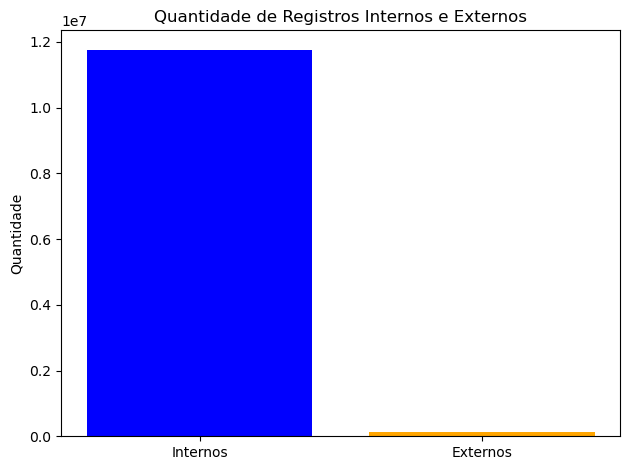

Estatísticas descritivas salvas em: bd/dados_por_produtor/estatisticas_descritivas.csv
Valores nulos por coluna salvos em: bd/dados_por_produtor/valores_nulos_por_coluna.csv
Tabela de registros por destino salva em: bd/dados_por_produtor/tabela_registros_por_destino.csv


In [1]:
import pandas as pd
import os
import matplotlib.pyplot as plt

def process_and_analyze_data(file1, file2, output_folder):
    df1 = pd.read_csv(file1)
    df2 = pd.read_csv(file2)
    df1.rename(columns={"id_gta_origem_outro_estado": "id_gta"}, inplace=True)
    combined_df = pd.concat([df1, df2], ignore_index=True)

    combined_df["id_produtor_destino"] = (
        combined_df["id_produtor_destino"]
        .dropna()
        .apply(lambda x: str(int(float(x))) if pd.notna(x) else x)
    )
    combined_df["id_produtor_origem"] = (
        combined_df["id_produtor_origem"]
        .dropna()
        .apply(lambda x: str(int(float(x))) if pd.notna(x) else x)
    )

    if not os.path.exists(output_folder):
        os.makedirs(output_folder)

    for produtor, group in combined_df.groupby("id_produtor_destino"):
        produtor_filename = f"{output_folder}/produtor_{produtor}.csv"
        group.to_csv(produtor_filename, sep=";", index=False)
        print(f"Dados salvos para o produtor {produtor}: {produtor_filename}")

    registros_internos = combined_df[combined_df["estado_origem"] == combined_df["estado_destino"]]
    registros_externos = combined_df[combined_df["estado_origem"] != combined_df["estado_destino"]]

    plt.bar(["Internos", "Externos"], [len(registros_internos), len(registros_externos)], color=["blue", "orange"])
    plt.title("Quantidade de Registros Internos e Externos")
    plt.ylabel("Quantidade")
    plt.tight_layout()
    histograma_file = f"{output_folder}/histograma_internos_vs_externos.png"
    plt.savefig(histograma_file)
    print(f"Histograma salvo em: {histograma_file}")
    plt.show()

    estatisticas_file = f"{output_folder}/estatisticas_descritivas.csv"
    combined_df.describe().to_csv(estatisticas_file, sep=";", index=False)
    print(f"Estatísticas descritivas salvas em: {estatisticas_file}")

    null_counts = combined_df.isnull().sum().reset_index()
    null_counts.columns = ["coluna", "valores_nulos"]
    valores_nulos_file = f"{output_folder}/valores_nulos_por_coluna.csv"
    null_counts.to_csv(valores_nulos_file, sep=";", index=False)
    print(f"Valores nulos por coluna salvos em: {valores_nulos_file}")

    gerar_tabela_por_destino(file1, file2, output_folder)

def gerar_tabela_por_destino(file1, file2, output_folder):
    df1 = pd.read_csv(file1)
    df2 = pd.read_csv(file2)
    df1.rename(columns={"id_gta_origem_outro_estado": "id_gta"}, inplace=True)
    combined_df = pd.concat([df1, df2], ignore_index=True)

    combined_df["id_produtor_destino"] = (
        combined_df["id_produtor_destino"]
        .dropna()
        .apply(lambda x: str(int(float(x))) if pd.notna(x) else x)
    )

    registros_por_destino = combined_df["id_produtor_destino"].value_counts().reset_index()
    registros_por_destino.columns = ["id_produtor_destino", "quantidade_registros"]

    tabela_destinos_file = f"{output_folder}/tabela_registros_por_destino.csv"
    registros_por_destino.to_csv(tabela_destinos_file, sep=";", index=False)
    print(f"Tabela de registros por destino salva em: {tabela_destinos_file}")
file1 = "bd/bd_gta_estado_MG_202501311609.csv"
file2 = "bd/bd_gta_origem_outro_estado_202501311605.csv"
output_folder = "bd/dados_por_produtor"

process_and_analyze_data(file1, file2, output_folder)


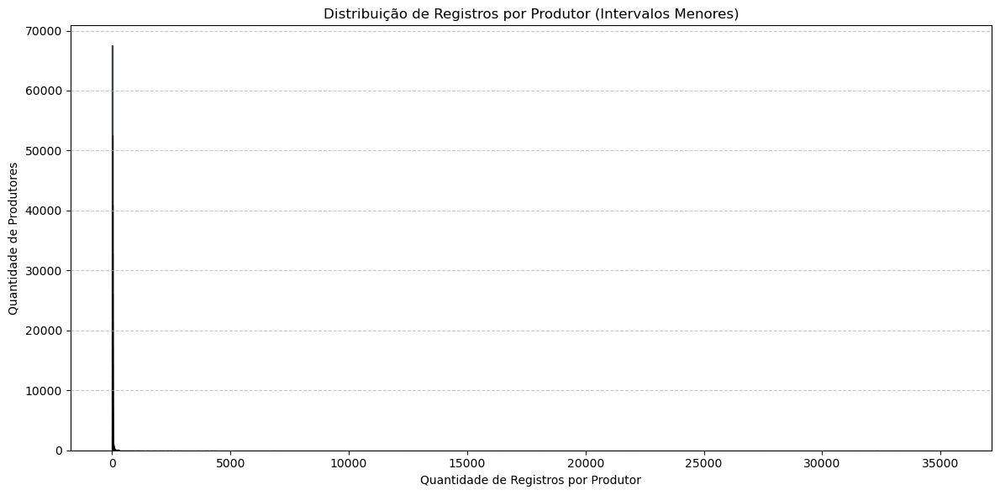

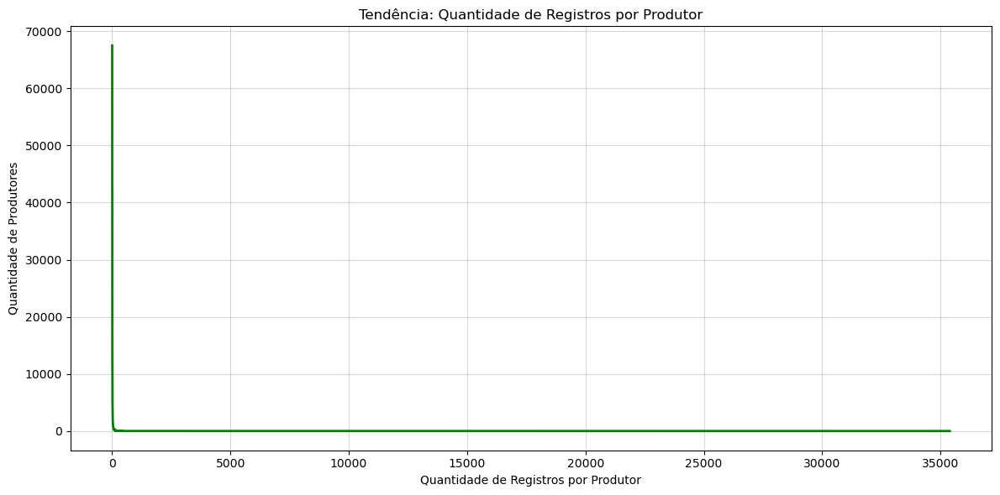

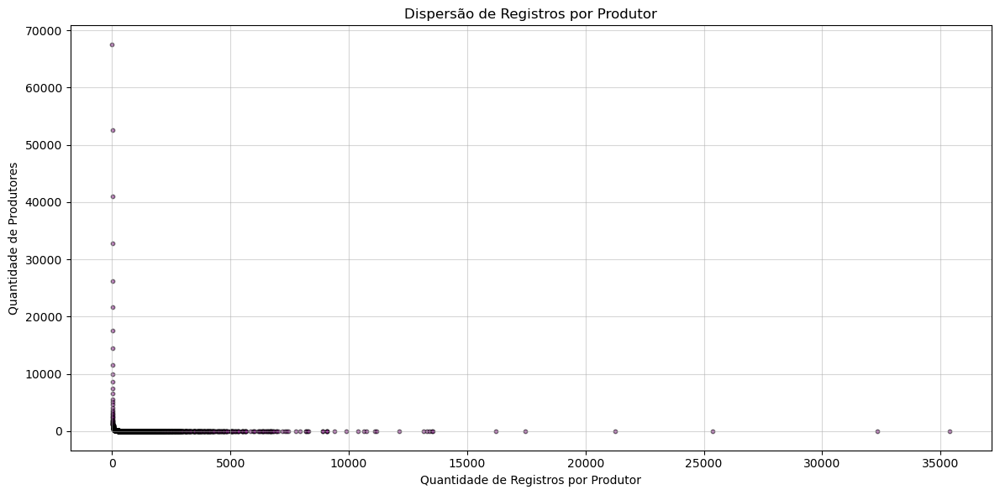

In [2]:
import pandas as pd
import matplotlib.pyplot as plt

def gerar_grafico_filtrado(file1, file2, min_produtores=100):
    df1 = pd.read_csv(file1)
    df2 = pd.read_csv(file2)

    df1.rename(columns={"id_gta_origem_outro_estado": "id_gta"}, inplace=True)
    combined_df = pd.concat([df1, df2], ignore_index=True)

    combined_df["id_produtor_destino"] = (
        combined_df["id_produtor_destino"]
        .dropna() 
        .apply(lambda x: str(int(float(x))) if pd.notna(x) else x)
    )

    registros_por_produtor = combined_df["id_produtor_destino"].value_counts()
    distribuicao = registros_por_produtor.value_counts().sort_index()
    distribuicao_filtrada = distribuicao[distribuicao >= min_produtores]

    plt.figure(figsize=(12, 6))
    plt.bar(distribuicao_filtrada.index, distribuicao_filtrada.values, color="skyblue", edgecolor="black", alpha=0.7)
    plt.title("Distribuição de Registros por Produtor (Intervalos Menores)")
    plt.xlabel("Quantidade de Registros por Produtor")
    plt.ylabel("Quantidade de Produtores")
    plt.grid(axis="y", linestyle="--", alpha=0.7)
    plt.tight_layout()
    plt.show()

    plt.figure(figsize=(12, 6))
    plt.plot(distribuicao_filtrada.index, distribuicao_filtrada.values, color="green", lw=2)
    plt.title("Tendência: Quantidade de Registros por Produtor")
    plt.xlabel("Quantidade de Registros por Produtor")
    plt.ylabel("Quantidade de Produtores")
    plt.grid(alpha=0.5)
    plt.tight_layout()
    plt.show()

    plt.figure(figsize=(12, 6))
    plt.scatter(
        x=distribuicao_filtrada.index, 
        y=distribuicao_filtrada.values, 
        alpha=0.5, color="purple", edgecolors="black", s=10
    )
    plt.title("Dispersão de Registros por Produtor")
    plt.xlabel("Quantidade de Registros por Produtor")
    plt.ylabel("Quantidade de Produtores")
    plt.grid(alpha=0.5)
    plt.tight_layout()
    plt.show()
file1 = "bd/bd_gta_estado_MG_202501311609.csv"
file2 = "bd/bd_gta_origem_outro_estado_202501311605.csv"
gerar_grafico_filtrado(file1, file2, min_produtores=1)


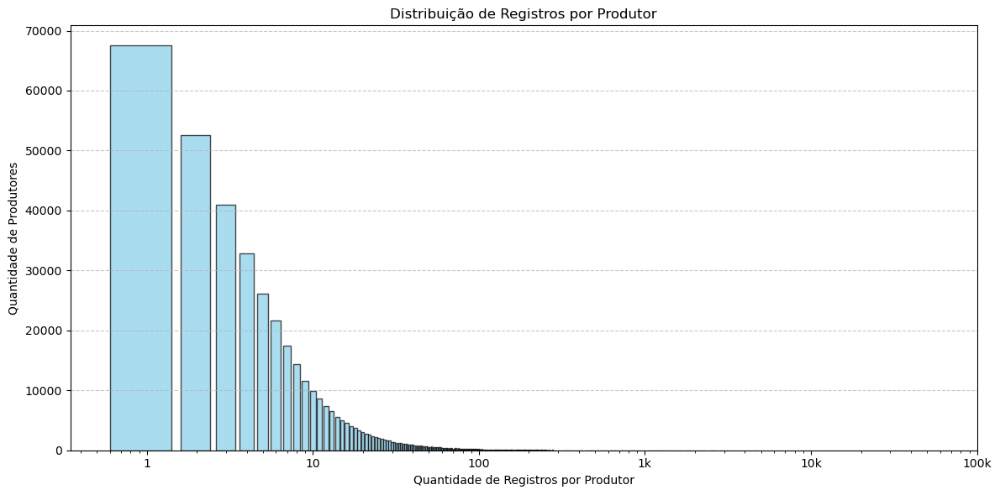

In [27]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

def gerar_grafico_filtrado(file1, file2, min_produtores=10):
    df1 = pd.read_csv(file1)
    df2 = pd.read_csv(file2)

    df1.rename(columns={"id_gta_origem_outro_estado": "id_gta"}, inplace=True)
    combined_df = pd.concat([df1, df2], ignore_index=True)

    combined_df["id_produtor_destino"] = (
        combined_df["id_produtor_destino"]
        .dropna()
        .apply(lambda x: str(int(float(x))) if pd.notna(x) else x)
    )

    registros_por_produtor = combined_df["id_produtor_destino"].value_counts()
    distribuicao = registros_por_produtor.value_counts().sort_index()
    distribuicao_filtrada = distribuicao[distribuicao >= min_produtores]

    plt.figure(figsize=(12, 6))
    plt.bar(distribuicao_filtrada.index, distribuicao_filtrada.values, color="skyblue", edgecolor="black", alpha=0.7)
    plt.title("Distribuição de Registros por Produtor")
    plt.xlabel("Quantidade de Registros por Produtor")
    plt.ylabel("Quantidade de Produtores")
    plt.grid(axis="y", linestyle="--", alpha=0.7)
    plt.xscale("log")
    plt.xticks(
        [1, 10, 100, 1000, 10000, 100000], 
        labels=["1", "10", "100", "1k", "10k", "100k"]
    )
    
    plt.tight_layout()
    plt.show()


file1 = "bd/bd_gta_estado_MG_202501311609.csv"
file2 = "bd/bd_gta_origem_outro_estado_202501311605.csv"

gerar_grafico_filtrado(file1, file2, min_produtores=1)


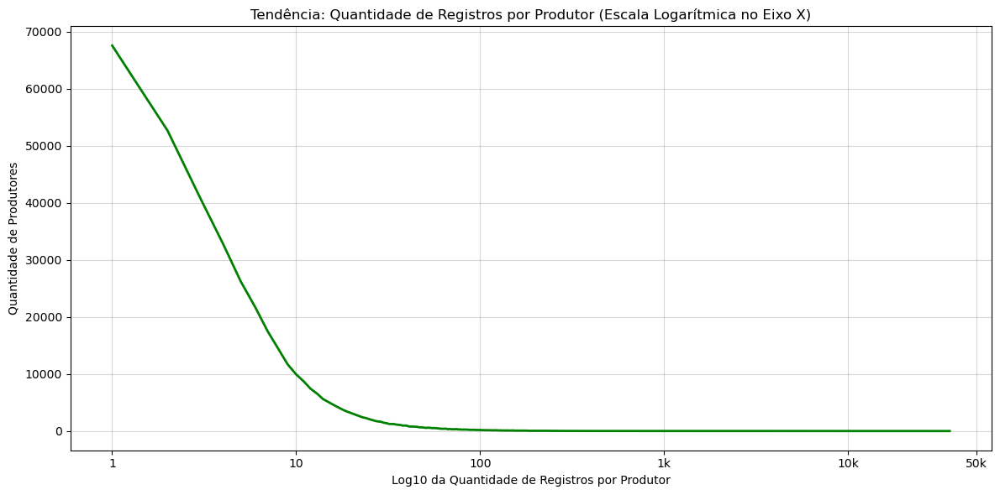

In [12]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

def mostrar_grafico_tendencia(file1, file2):
    df1 = pd.read_csv(file1)
    df2 = pd.read_csv(file2)

    df1.rename(columns={"id_gta_origem_outro_estado": "id_gta"}, inplace=True)
    combined_df = pd.concat([df1, df2], ignore_index=True)
    combined_df["id_produtor_destino"] = combined_df["id_produtor_destino"].dropna()
    registros_por_produtor = combined_df["id_produtor_destino"].value_counts()
    frequencia_registros = registros_por_produtor.value_counts().sort_index()

    distribuicao_filtrada_log = np.log10(frequencia_registros.index)
    
    plt.figure(figsize=(12, 6))
    plt.plot(distribuicao_filtrada_log, frequencia_registros.values, color="green", lw=2)
    plt.title("Tendência: Quantidade de Registros por Produtor (Escala Logarítmica no Eixo X)")
    plt.xlabel("Log10 da Quantidade de Registros por Produtor")
    plt.ylabel("Quantidade de Produtores")
    plt.grid(alpha=0.5)
    plt.xticks(np.log10([1, 10, 100, 1000, 10000, 50000]), labels=["1", "10", "100", "1k", "10k", "50k"])
    
    plt.tight_layout()
    plt.show()

file1 = "bd/bd_gta_estado_MG_202501311609.csv"
file2 = "bd/bd_gta_origem_outro_estado_202501311605.csv"
mostrar_grafico_tendencia(file1, file2)

In [31]:
def mostrar_top_30(file1, file2):
    #df1 = pd.read_csv(file1)
    df2 = pd.read_csv(file2)

    df2.rename(columns={"id_gta_origem_outro_estado": "id_gta"}, inplace=True)
    #combined_df = pd.concat([df1, df2], ignore_index=True)
    combined_df = df2

    combined_df["id_produtor_destino"] = (
        combined_df["id_produtor_destino"]
        .dropna() 
        .apply(lambda x: str(int(float(x))) if pd.notna(x) else x)
    )

    registros_por_produtor = combined_df["id_produtor_destino"].value_counts()

    top_30 = registros_por_produtor.head(30)
    print("As 30 maiores quantidades de registros por produtor (sem valores nulos):")
    print(top_30)

file1 = "bd/bd_gta_estado_MG_202501311609.csv"
file2 = "bd/bd_gta_origem_outro_estado_202501311605.csv"

mostrar_top_30(file1, file2)


As 30 maiores quantidades de registros por produtor (sem valores nulos):
id_produtor_destino
23537     2471
434376    1362
289601    1356
711496    1295
463107    1256
289628    1115
302334    1115
17339     1070
561202     895
422727     789
289642     710
24825      632
21576      599
369665     587
177885     542
717047     537
76800      503
78287      488
270028     486
805536     473
18062      466
332899     453
292033     451
481865     422
270314     395
461329     395
620764     393
16035      386
20988      376
589631     363
Name: count, dtype: int64


Frequência das quantidades de registros por produtor:
count
1     4820
2     2713
3     1512
4     1011
5      711
6      526
7      365
8      321
9      254
10     189
11     189
12     158
13     133
14     104
15      92
16      81
17      79
18      62
19      51
20      59
21      58
22      46
23      42
24      39
25      35
26      49
27      32
28      38
29      26
30      28
Name: count, dtype: int64

Total de produtores com 10 ou mais registros: 2288
Total de produtores com menos de 10 registros: 12233
Total de produtores: 14521


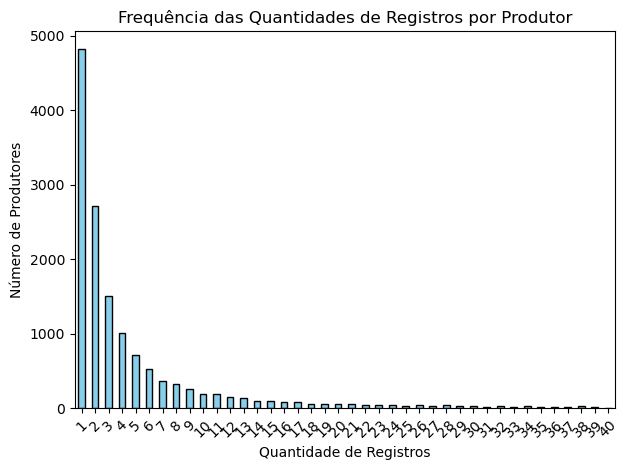

In [34]:
import pandas as pd
import matplotlib.pyplot as plt

def mostrar_frequencia_de_registros(file1, file2):
    #df1 = pd.read_csv(file1)
    df2 = pd.read_csv(file2)

    df2.rename(columns={"id_gta_origem_outro_estado": "id_gta"}, inplace=True)
    #combined_df = pd.concat([df1, df2], ignore_index=True)
    combined_df = df2
    combined_df["id_produtor_destino"] = combined_df["id_produtor_destino"].dropna()
    registros_por_produtor = combined_df["id_produtor_destino"].value_counts()
    frequencia_registros = registros_por_produtor.value_counts().sort_index()

    print("Frequência das quantidades de registros por produtor:")
    print(frequencia_registros.head(30))

    soma = 0
    total = 0
    for quantidade, quantidade_produtores in frequencia_registros.items():
        if quantidade >= 10:
            soma = soma + quantidade_produtores
    print(f"\nTotal de produtores com 10 ou mais registros: {soma}")
    total += soma

    soma = 0
    for quantidade, quantidade_produtores in frequencia_registros.items():
        if quantidade < 10:
            soma = soma + quantidade_produtores
    print(f"Total de produtores com menos de 10 registros: {soma}")
    total += soma
    print(f"Total de produtores: {total}")

    frequencia_registros.head(40).plot(kind='bar', color='skyblue', edgecolor='black')
    plt.title("Frequência das Quantidades de Registros por Produtor")
    plt.xlabel("Quantidade de Registros")
    plt.ylabel("Número de Produtores")
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()

file1 = "bd/bd_gta_estado_MG_202501311609.csv"
file2 = "bd/bd_gta_origem_outro_estado_202501311605.csv"
mostrar_frequencia_de_registros(file1, file2)


count    1.184008e+07
mean     1.267794e+01
std      1.727515e+01
min      1.000000e+00
25%      2.000000e+00
50%      6.000000e+00
75%      1.600000e+01
max      1.500000e+02
Name: qt_animais, dtype: float64
Frequência das quantidades de registros por produtor:
count
1     67600
2     52648
3     40941
4     32836
5     26205
6     21689
7     17485
8     14344
9     11667
10     9922
11     8664
12     7371
13     6555
14     5580
15     5016
16     4581
17     4116
18     3683
19     3359
20     3131
21     2832
22     2585
23     2415
24     2257
25     2061
26     1907
27     1736
28     1668
29     1610
30     1441
Name: count, dtype: int64

Total de produtores com 10 ou mais registros: 135360
Total de produtores com menos de 10 registros: 285415
Total de produtores: 420775


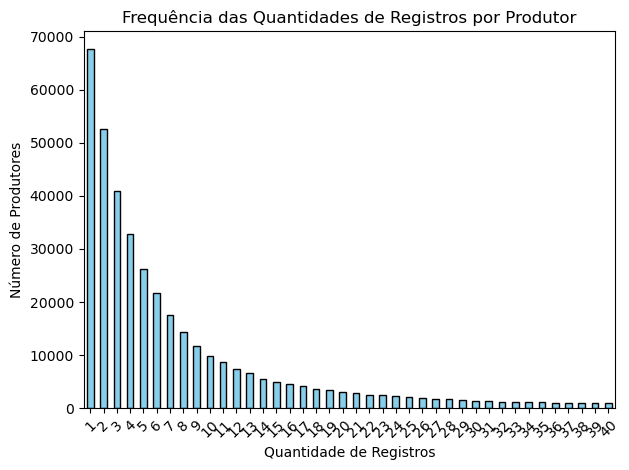

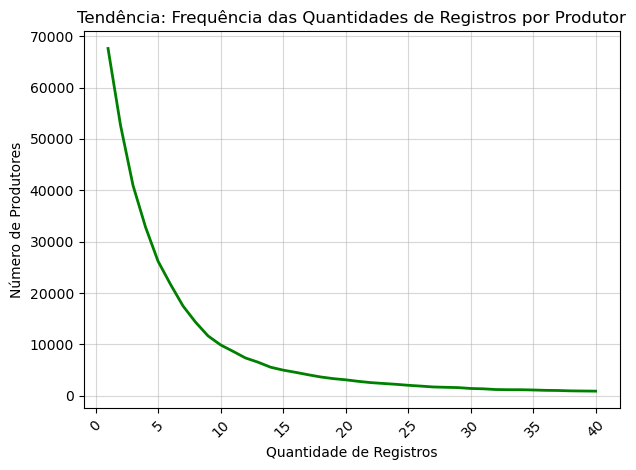

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

def mostrar_frequencia_de_registros(file1, file2):
    #df1 = pd.read_csv(file1)
    df2 = pd.read_csv(file2)

    df2.rename(columns={"id_gta_origem_outro_estado": "id_gta"}, inplace=True)
    #combined_df = pd.concat([df1, df2], ignore_index=True)
    combined_df = df2
    print(combined_df["qt_animais"].describe())
    combined_df["id_produtor_destino"] = combined_df["id_produtor_destino"].dropna()
    registros_por_produtor = combined_df["id_produtor_destino"].value_counts()
    frequencia_registros = registros_por_produtor.value_counts().sort_index()

    print("Frequência das quantidades de registros por produtor:")
    print(frequencia_registros.head(30))

    soma = 0
    total = 0
    for quantidade, quantidade_produtores in frequencia_registros.items():
        if quantidade >= 10:
            soma = soma + quantidade_produtores
    print(f"\nTotal de produtores com 10 ou mais registros: {soma}")
    total += soma

    soma = 0
    for quantidade, quantidade_produtores in frequencia_registros.items():
        if quantidade < 10:
            soma = soma + quantidade_produtores
    print(f"Total de produtores com menos de 10 registros: {soma}")
    total += soma
    print(f"Total de produtores: {total}")

    frequencia_registros.head(40).plot(kind='bar', color='skyblue', edgecolor='black')
    plt.title("Frequência das Quantidades de Registros por Produtor")
    plt.xlabel("Quantidade de Registros")
    plt.ylabel("Número de Produtores")
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()

    plt.plot(frequencia_registros.head(40).index, frequencia_registros.head(40).values, color="green", lw=2)
    plt.title("Tendência: Frequência das Quantidades de Registros por Produtor")
    plt.xlabel("Quantidade de Registros")
    plt.ylabel("Número de Produtores")
    plt.grid(alpha=0.5)
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()

file1 = "bd/bd_gta_estado_MG_202501311609.csv"
file2 = "bd/bd_gta_origem_outro_estado_202501311605.csv"
mostrar_frequencia_de_registros(file1, file2)


In [2]:
import pandas as pd

# Substitua pelos caminhos dos seus arquivos CSV
caminho_mg = "bd/bd_gta_estado_MG_202501311609.csv"
caminho_fora_mg = "bd/bd_gta_origem_outro_estado_202501311605.csv"

# Carregar os dados
df_mg = pd.read_csv(caminho_mg)
df_fora_mg = pd.read_csv(caminho_fora_mg)

# Exibir informações básicas
print(df_mg.info())
print(df_fora_mg.info())


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 11840077 entries, 0 to 11840076
Data columns (total 10 columns):
 #   Column                  Dtype  
---  ------                  -----  
 0   id_gta                  int64  
 1   dt_emissao_gta          object 
 2   id_produtor_origem      float64
 3   id_produtor_destino     int64  
 4   id_tipo_finalidade_gta  int64  
 5   municipio_origem        int64  
 6   estado_origem           object 
 7   municipio_destino       int64  
 8   estado_destino          object 
 9   qt_animais              int64  
dtypes: float64(1), int64(6), object(3)
memory usage: 903.3+ MB
None
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 131461 entries, 0 to 131460
Data columns (total 10 columns):
 #   Column                      Non-Null Count   Dtype 
---  ------                      --------------   ----- 
 0   id_gta_origem_outro_estado  131461 non-null  int64 
 1   dt_emissao_gta              131461 non-null  object
 2   id_produtor_origem          

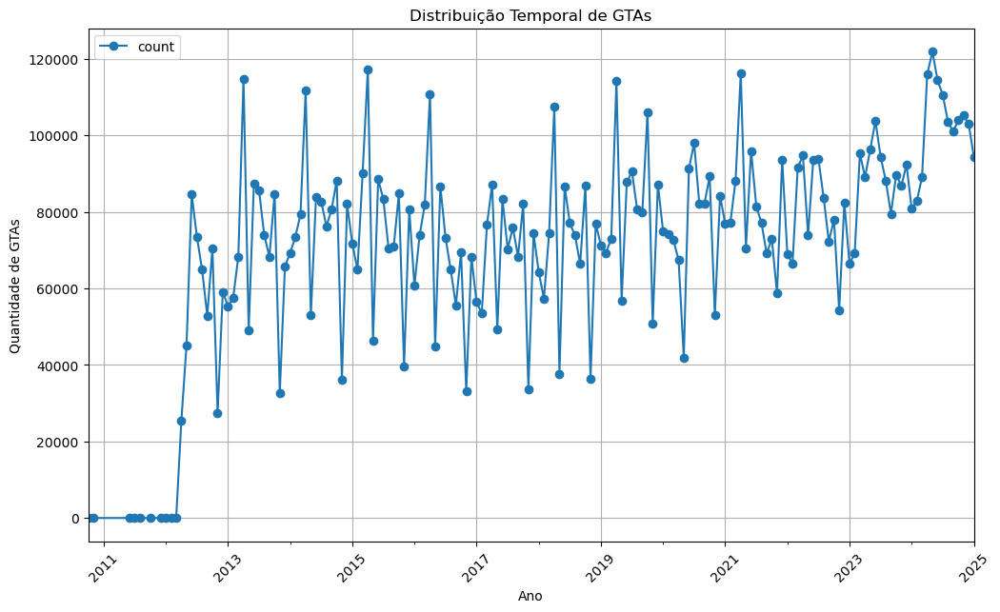

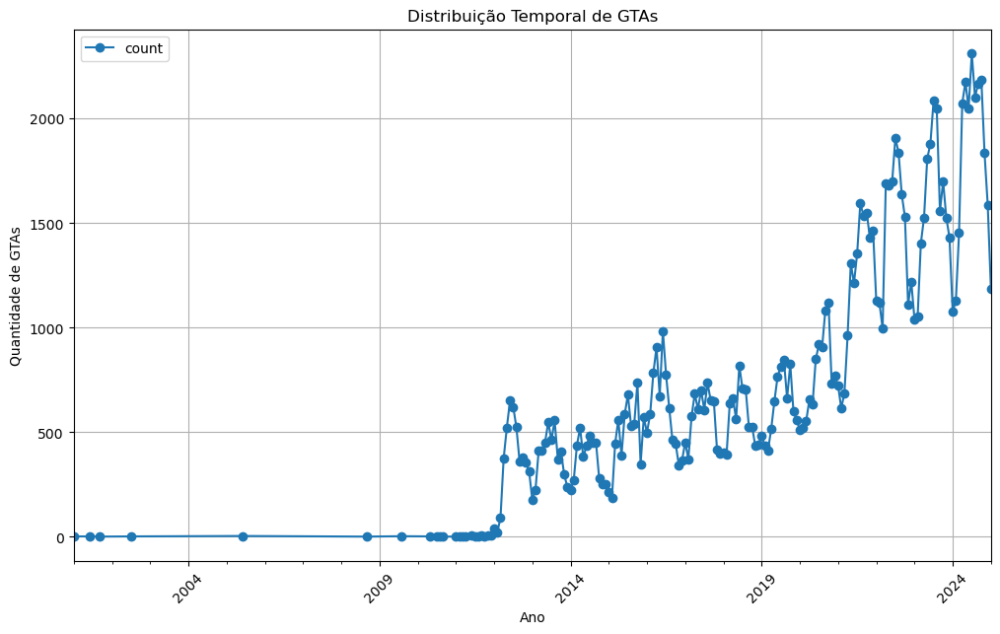

In [29]:
import pandas as pd
import matplotlib.pyplot as plt

def corrigir_datas(df, coluna):
    df[coluna] = pd.to_datetime(df[coluna], errors="coerce")
    df = df.dropna(subset=[coluna]) 
    df = df[(df[coluna] >= "1990-01-01") & (df[coluna] <= pd.Timestamp.today())]
    return df

df_mg = corrigir_datas(df_mg, "dt_emissao_gta")
df_fora_mg = corrigir_datas(df_fora_mg, "dt_emissao_gta")

df_mg["ano_mes"] = df_mg["dt_emissao_gta"].dt.to_period("M")
df_fora_mg["ano_mes"] = df_fora_mg["dt_emissao_gta"].dt.to_period("M")

# Gráfico para MG
plt.figure(figsize=(12, 7))
df_mg["ano_mes"].value_counts().sort_index().plot(marker="o")
plt.xlabel("Ano")
plt.ylabel("Quantidade de GTAs")
plt.title("Distribuição Temporal de GTAs")
plt.legend()
plt.grid()
plt.xticks(rotation=45)
plt.show()

# Gráfico para Fora MG
plt.figure(figsize=(12, 7))
df_fora_mg["ano_mes"].value_counts().sort_index().plot( marker="o")
plt.xlabel("Ano")
plt.ylabel("Quantidade de GTAs")
plt.title("Distribuição Temporal de GTAs")
plt.legend()
plt.grid()
plt.xticks(rotation=45)
plt.show()


In [13]:
df_mg_2094 = df_mg[df_mg["dt_emissao_gta"].dt.year >  2025]
df_fora_mg_2094 = df_fora_mg[df_fora_mg["dt_emissao_gta"].dt.year > 2025]

# Exibir as linhas encontradas
print("Registros em df_mg com ano maior que 2025:")
print(df_mg_2094)
print("Número de registros em df_mg com ano maior que 2025", len(df_mg_2094))

print("\nRegistros em df_fora_mg com ano maior que 2025:")
print(df_fora_mg_2094)


Registros em df_mg com ano maior que 2025:
Empty DataFrame
Columns: [id_gta, dt_emissao_gta, id_produtor_origem, id_produtor_destino, id_tipo_finalidade_gta, municipio_origem, estado_origem, municipio_destino, estado_destino, qt_animais, ano_mes]
Index: []
Número de registros em df_mg com ano maior que 2025 0

Registros em df_fora_mg com ano maior que 2025:
Empty DataFrame
Columns: [id_gta_origem_outro_estado, dt_emissao_gta, id_produtor_origem, id_produtor_destino, id_tipo_finalidade_gta, municipio_origem, estado_origem, municipio_destino, estado_destino, qt_animais, ano_mes]
Index: []


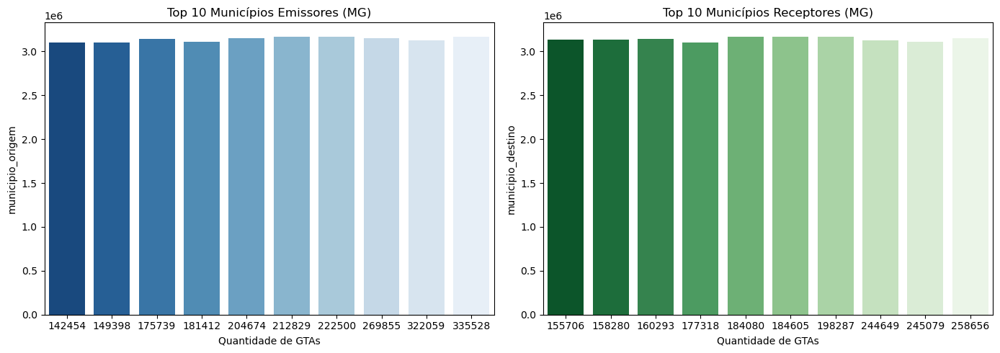

In [4]:
import seaborn as sns

# Top 10 municípios emissores e receptores dentro de MG
top_municipios_origem = df_mg["municipio_origem"].value_counts().head(10)
top_municipios_destino = df_mg["municipio_destino"].value_counts().head(10)

# Plotagem
fig, ax = plt.subplots(1, 2, figsize=(14, 5))

sns.barplot(y=top_municipios_origem.index, x=top_municipios_origem.values, ax=ax[0], palette="Blues_r")
ax[0].set_title("Top 10 Municípios Emissores (MG)")
ax[0].set_xlabel("Quantidade de GTAs")

sns.barplot(y=top_municipios_destino.index, x=top_municipios_destino.values, ax=ax[1], palette="Greens_r")
ax[1].set_title("Top 10 Municípios Receptores (MG)")
ax[1].set_xlabel("Quantidade de GTAs")

plt.tight_layout()
plt.show()


d:\Anaconda\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
d:\Anaconda\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


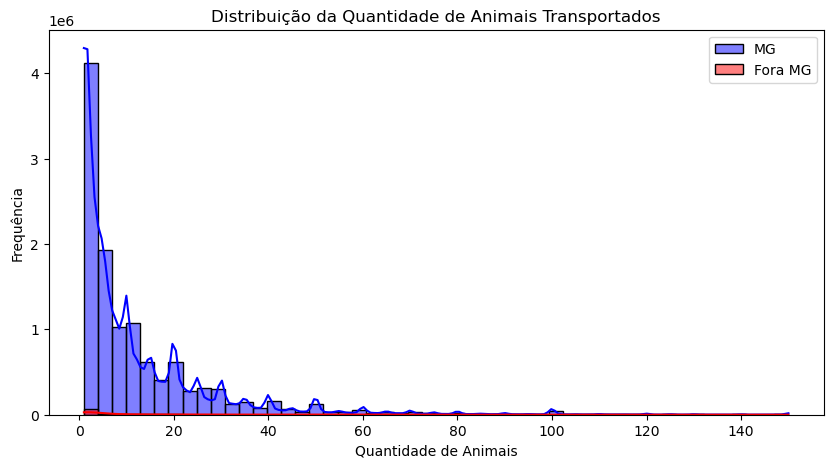

In [5]:
plt.figure(figsize=(10, 5))
sns.histplot(df_mg["qt_animais"], bins=50, kde=True, color="blue", label="MG")
sns.histplot(df_fora_mg["qt_animais"], bins=50, kde=True, color="red", label="Fora MG")

plt.xlabel("Quantidade de Animais")
plt.ylabel("Frequência")
plt.title("Distribuição da Quantidade de Animais Transportados")
plt.legend()
plt.show()


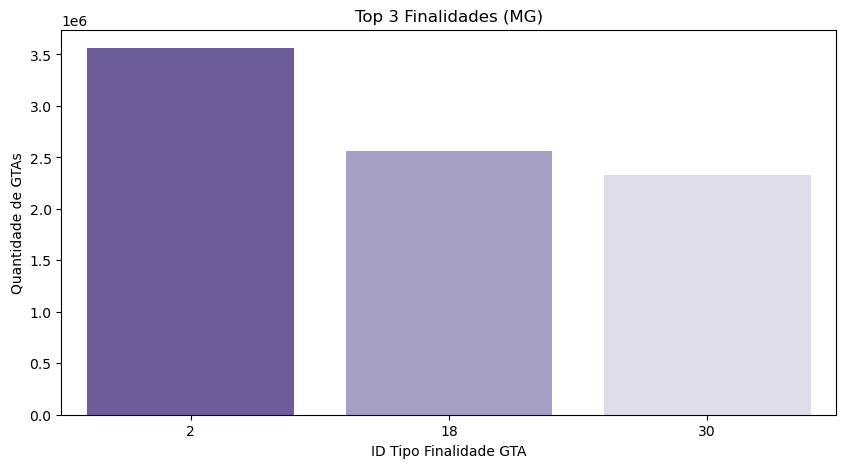

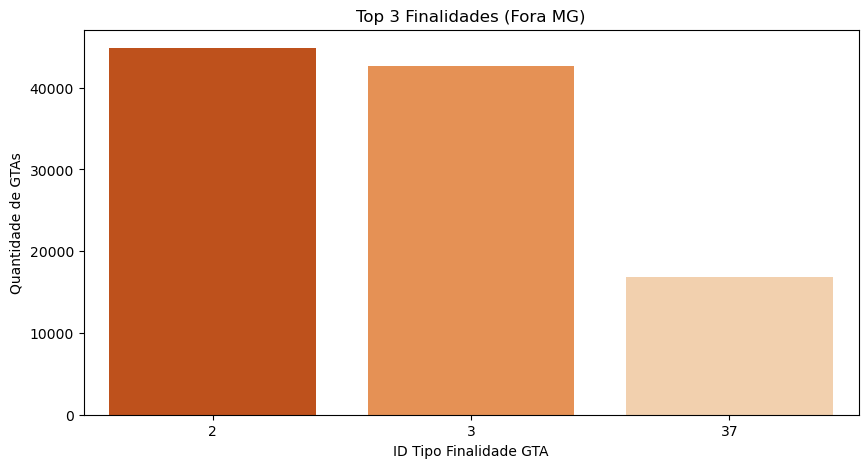

In [22]:
import matplotlib.pyplot as plt
import seaborn as sns

# Contagem das finalidades mais comuns
top_finalidades_mg = df_mg["id_tipo_finalidade_gta"].value_counts().head(3)
top_finalidades_fora_mg = df_fora_mg["id_tipo_finalidade_gta"].value_counts().head(3)

# Plotagem para MG
plt.figure(figsize=(10, 5))
sns.barplot(y=top_finalidades_mg.values, x=top_finalidades_mg.index, palette="Purples_r")
plt.title("Top 3 Finalidades (MG)")
plt.ylabel("Quantidade de GTAs")
plt.xlabel("ID Tipo Finalidade GTA")
plt.show()

# Plotagem para Fora MG
plt.figure(figsize=(10, 5))
sns.barplot(y=top_finalidades_fora_mg.values, x=top_finalidades_fora_mg.index, palette="Oranges_r")
plt.title("Top 3 Finalidades (Fora MG)")
plt.ylabel("Quantidade de GTAs")
plt.xlabel("ID Tipo Finalidade GTA")
plt.show()


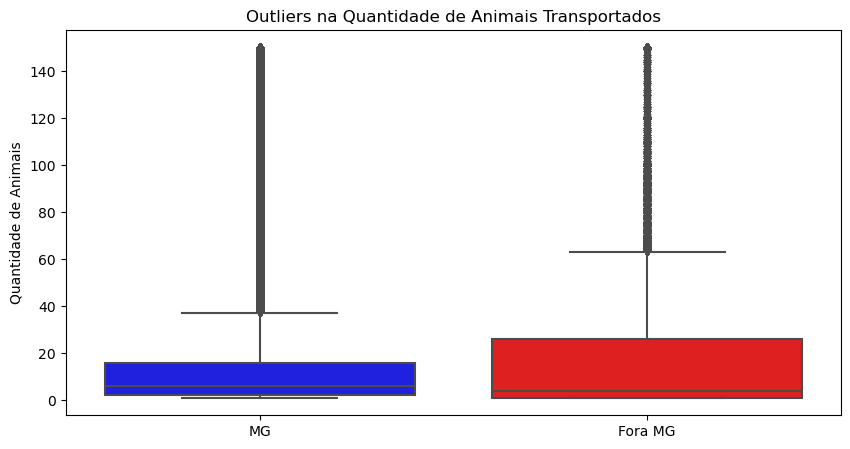

In [17]:
plt.figure(figsize=(10, 5))
sns.boxplot(data=[df_mg["qt_animais"], df_fora_mg["qt_animais"]], palette=["blue", "red"])
plt.xticks([0, 1], ["MG", "Fora MG"])
plt.ylabel("Quantidade de Animais")
plt.title("Outliers na Quantidade de Animais Transportados")
plt.show()


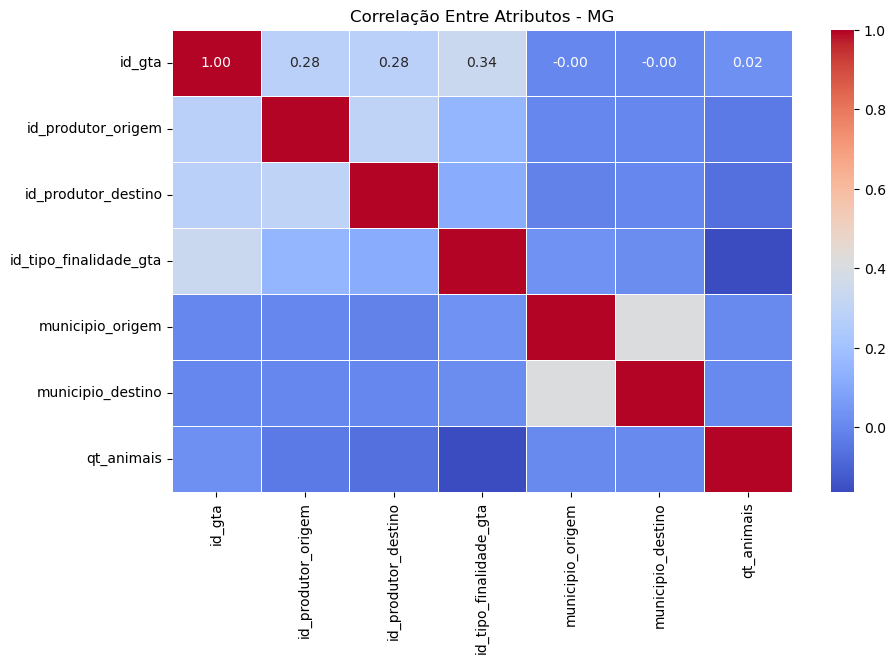

In [18]:
# Mapa de calor das correlações
plt.figure(figsize=(10, 6))
sns.heatmap(df_mg.corr(numeric_only=True), annot=True, cmap="coolwarm", fmt=".2f", linewidths=0.5)
plt.title("Correlação Entre Atributos - MG")
plt.show()


In [19]:
produtores_origem = set(df_mg["id_produtor_origem"].dropna().unique())
produtores_destino = set(df_mg["id_produtor_destino"].dropna().unique())

produtores_apenas_receptores = produtores_destino - produtores_origem
print(f"Quantidade de produtores que apenas recebem: {len(produtores_apenas_receptores)}")


Quantidade de produtores que apenas recebem: 71701


In [ ]:
import pandas as pd
import numpy as np
import os
from sklearn.cluster import DBSCAN
from sklearn.preprocessing import MinMaxScaler
import matplotlib.pyplot as plt

def count_records(combined_file):
    combined_df = pd.read_csv(combined_file)
    combined_df = combined_df.dropna(subset=["id_produtor_destino"])
    combined_df["id_produtor_destino"] = combined_df["id_produtor_destino"].apply(lambda x: str(int(float(x))) if isinstance(x, (int, float)) else str(x))
    combined_df["id_produtor_origem"] = (
        combined_df["id_produtor_origem"]
        .dropna()
        .apply(lambda x: str(int(float(x))) if pd.notna(x) else x)
    )
    registros_por_produtor = combined_df["id_produtor_destino"].value_counts().reset_index()
    registros_por_produtor.columns = ["id_produtor_destino", "count"]
    if not os.path.exists("clusters"):
        os.makedirs("clusters")
    return registros_por_produtor, combined_df

def select_producers(registros_por_produtor):
    registros_por_produtor = registros_por_produtor.sort_values(by="count", ascending=False)
    top_2 = registros_por_produtor.head(2)
    group_10000 = registros_por_produtor.iloc[
        (registros_por_produtor["count"] - 10000).abs().argsort()[:2]
    ]
    group_1000 = registros_por_produtor.iloc[
        (registros_por_produtor["count"] - 1000).abs().argsort()[:2]
    ]
    group_100 = registros_por_produtor.iloc[
        (registros_por_produtor["count"] - 100).abs().argsort()[:2]
    ]
    group_10 = registros_por_produtor.iloc[
        (registros_por_produtor["count"] - 10).abs().argsort()[:2]
    ]
    selected_producers = {
        "TOP 2": top_2,
        "TOP 10000": group_10000,
        "TOP 1000": group_1000,
        "TOP 100": group_100,
        "TOP 10": group_10,
    }
    return selected_producers

def preprocess_data(producer_id, combined_df):
    combined_df["id_produtor_destino"] = combined_df["id_produtor_destino"].astype(str)
    filtered_df = combined_df[combined_df["id_produtor_destino"] == producer_id].copy()
    filtered_df["dt_emissao_gta"] = pd.to_datetime(filtered_df["dt_emissao_gta"])
    
    max_date = filtered_df["dt_emissao_gta"].max()
    print(f"Data mais recente para o produtor {producer_id}: {max_date}")
    
    filtered_df.loc[:, "data_diff"] = (filtered_df["dt_emissao_gta"] - filtered_df["dt_emissao_gta"].min()).dt.total_seconds()
    scaler = MinMaxScaler()
    normalized_data = scaler.fit_transform(filtered_df[["qt_animais", "data_diff"]])
    filtered_df.loc[:, "qt_animais_norm"] = normalized_data[:, 0]
    filtered_df.loc[:, "data_diff_norm"] = normalized_data[:, 1]
    return filtered_df

def cluster_producers(df, eps=0.5, min_samples=2):
    features = df[["qt_animais_norm", "data_diff_norm"]]
    dbscan = DBSCAN(eps=eps, min_samples=min_samples, metric="euclidean")
    clusters = dbscan.fit_predict(features)
    df.loc[:, "cluster"] = clusters
    return df

def plot_clusters(df, producer_id, faixa):
    plt.scatter(df["qt_animais_norm"], df["data_diff_norm"], c=df["cluster"], cmap="viridis", s=50)
    plt.colorbar(label="Cluster")
    plt.xlabel("Quantidade de Animais (Normalizado)")
    plt.ylabel("Diferença de Tempo (Normalizado)")
    plt.title(f"{faixa} - Produtor {producer_id}")
    plt.show()

def save_producer_data(df, producer_id, file_prefix):
    producer_data = df[df["id_produtor_destino"] == str(producer_id)]
    producer_data.to_csv(f"{file_prefix}_produtor_{producer_id}.csv", sep=";", index=False, columns=["id_produtor_destino", "id_produtor_origem", "qt_animais", "dt_emissao_gta", "data_diff", "cluster"])

def save_fraud_candidates(df, file_name):
    fraud_candidates = df[df["cluster"] == -1]
    fraud_candidates.to_csv(file_name, sep=";", index=False)

combined_file = "bd/dados_combinados.csv"

registros_por_produtor, combined_df = count_records(combined_file)

selected_producers = select_producers(registros_por_produtor)

all_clusters = []
for faixa, producers in selected_producers.items():
    print(f"Processando produtores da faixa: {faixa}")
    
    for _, row in producers.iterrows():
        producer_id = row["id_produtor_destino"]
        print(f"  Processando produtor {producer_id}...")
        processed_data = preprocess_data(producer_id, combined_df)
        clustered_data = cluster_producers(processed_data, eps=0.3, min_samples=2)
        all_clusters.append(clustered_data)
        plot_clusters(clustered_data, producer_id, faixa)
        save_producer_data(clustered_data, producer_id, f"clusters/{faixa}")
save_fraud_candidates(pd.concat(all_clusters), "clusters/fraudes.csv")

Data mais recente: 2023-06-28 10:55:17.469000


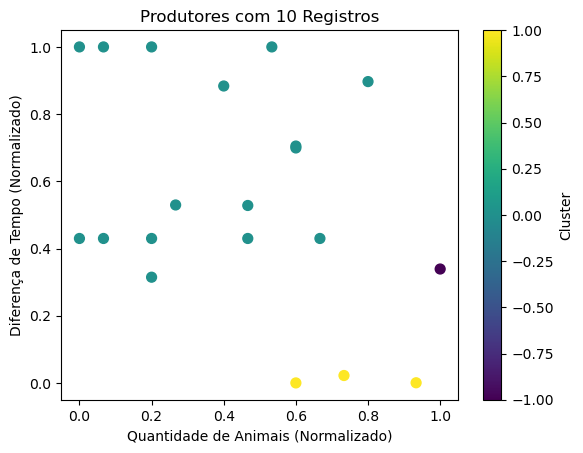

Data mais recente: 2024-12-03 10:33:40.127000


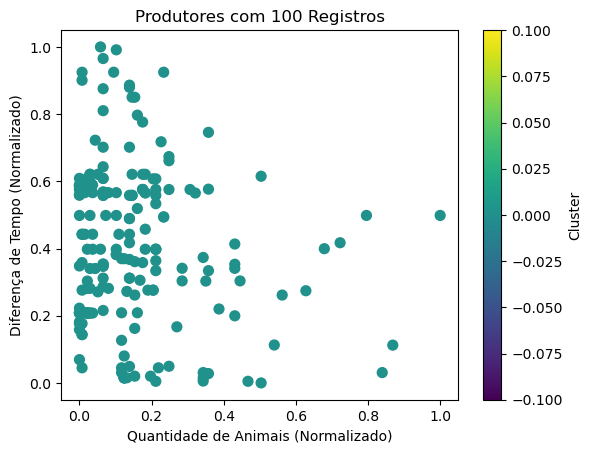

Data mais recente: 2025-01-06 10:35:48.124000


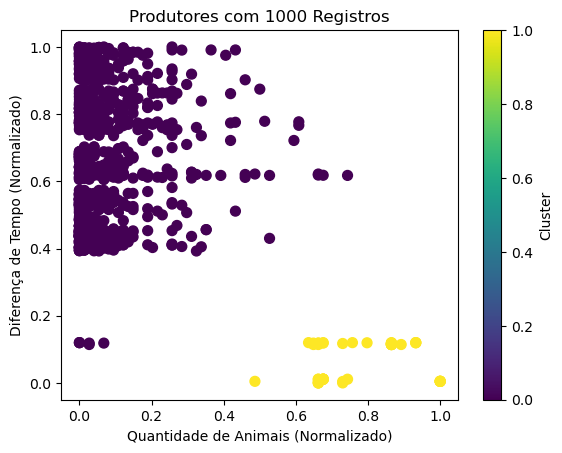

Data mais recente: 2024-12-20 14:09:37.242000


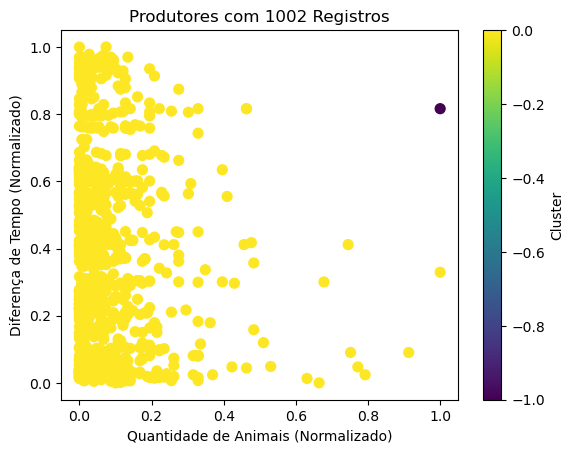

Data mais recente: 2025-01-07 16:07:05.881000


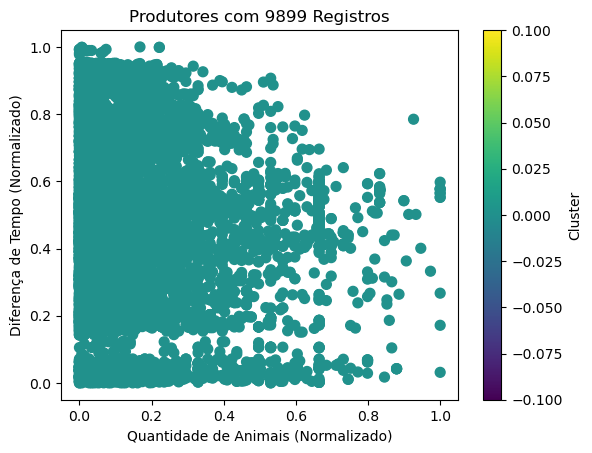

Data mais recente: 2025-01-07 11:39:42.334000


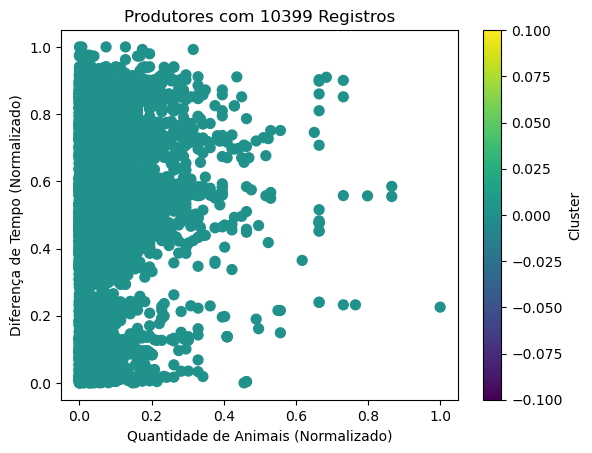

Data mais recente: 2025-01-08 17:30:10.503000


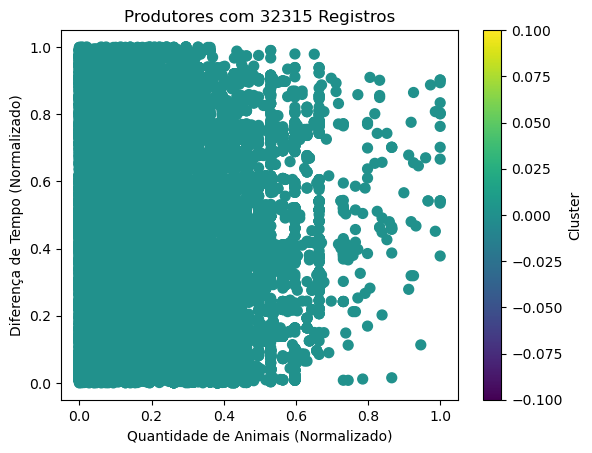

Data mais recente: 2025-01-08 13:12:15.552000


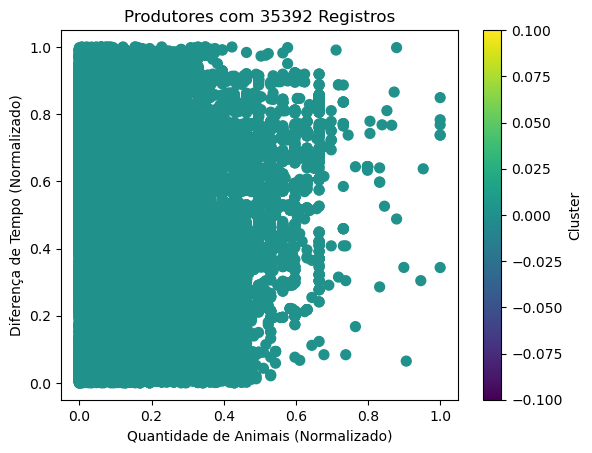

In [22]:
import pandas as pd
import numpy as np
import os
from sklearn.cluster import DBSCAN
from sklearn.preprocessing import MinMaxScaler
import matplotlib.pyplot as plt

def count_records(combined_file):
    combined_df = pd.read_csv(combined_file)
    combined_df = combined_df.dropna(subset=["id_produtor_destino"])
    combined_df = combined_df.dropna(subset=["id_produtor_origem"])
    combined_df["id_produtor_destino"] = combined_df["id_produtor_destino"].apply(lambda x: str(int(float(x))) if isinstance(x, (int, float)) else str(x))
    combined_df["id_produtor_origem"] = combined_df["id_produtor_origem"].apply(lambda x: str(int(float(x))) if isinstance(x, (int, float)) else str(x))
    registros_por_produtor = combined_df["id_produtor_destino"].value_counts().reset_index()
    registros_por_produtor.columns = ["id_produtor_destino", "count"]

    if not os.path.exists("clusters"):
        os.makedirs("clusters")

    return registros_por_produtor, combined_df

def select_producers(registros_por_produtor):
    registros_por_produtor = registros_por_produtor.sort_values(by="count", ascending=False)
    top_2 = registros_por_produtor.head(2)
    group_10000 = registros_por_produtor.iloc[
        (registros_por_produtor["count"] - 10000).abs().argsort()[:2]
    ]
    group_1000 = registros_por_produtor.iloc[
        (registros_por_produtor["count"] - 1000).abs().argsort()[:2]
    ]
    group_100 = registros_por_produtor.iloc[
        (registros_por_produtor["count"] - 100).abs().argsort()[:2]
    ]
    group_10 = registros_por_produtor.iloc[
        (registros_por_produtor["count"] - 10).abs().argsort()[:2]
    ]
    selected_producers = pd.concat([top_2, group_10000, group_1000, group_100, group_10])
    selected_producers["id_produtor_destino"] = selected_producers["id_produtor_destino"].astype(str)
    return selected_producers

def preprocess_data(df, combined_df):
    combined_df["id_produtor_destino"] = combined_df["id_produtor_destino"].astype(str)
    filtered_df = combined_df[combined_df["id_produtor_destino"].isin(df["id_produtor_destino"])].copy()
    filtered_df["dt_emissao_gta"] = pd.to_datetime(filtered_df["dt_emissao_gta"])
    filtered_df.loc[:, "data_diff"] = (filtered_df["dt_emissao_gta"].max() - filtered_df["dt_emissao_gta"]).dt.total_seconds()
    max_date = filtered_df["dt_emissao_gta"].max()
    print(f"Data mais recente: {max_date}")
    scaler = MinMaxScaler()
    normalized_data = scaler.fit_transform(filtered_df[["qt_animais", "data_diff"]])
    filtered_df.loc[:, "qt_animais_norm"] = normalized_data[:, 0]
    filtered_df.loc[:, "data_diff_norm"] = normalized_data[:, 1]
    return filtered_df

def cluster_producers(df, eps=0.3, min_samples=2):
    features = df[["qt_animais_norm", "data_diff_norm"]]
    dbscan = DBSCAN(eps=eps, min_samples=min_samples, metric="euclidean")
    clusters = dbscan.fit_predict(features)
    df.loc[:, "cluster"] = clusters
    return df

def plot_clusters(df, title):
    plt.scatter(df["qt_animais_norm"], df["data_diff_norm"], c=df["cluster"], cmap="viridis", s=50)
    plt.colorbar(label="Cluster")
    plt.xlabel("Quantidade de Animais (Normalizado)")
    plt.ylabel("Diferença de Tempo (Normalizado)")
    plt.title(title)
    plt.show()

def save_producer_data(df, producer_id, file_prefix):
    producer_data = df[df["id_produtor_destino"] == str(producer_id)]
    producer_data.to_csv(f"{file_prefix}_produtor_{producer_id}.csv", sep=";", index=False)

def save_fraud_candidates(df, file_name):
    fraud_candidates = df[df["cluster"] == -1]
    fraud_candidates.to_csv(file_name, sep=";", index=False)

combined_file = "bd/dados_combinados.csv"

registros_por_produtor, combined_df = count_records(combined_file)
selected_producers = select_producers(registros_por_produtor)

all_clusters = []
for index, producer_group in selected_producers.groupby("count"):
    processed_data = preprocess_data(producer_group, combined_df)
    clustered_data = cluster_producers(processed_data, eps=0.3, min_samples=2)
    all_clusters.append(clustered_data)
    plot_clusters(clustered_data, f"Produtores com {index} Registros")
    for producer_id in clustered_data["id_produtor_destino"].unique():
        save_producer_data(clustered_data, producer_id, "clusters/cluster_data")

all_clusters_df = pd.concat(all_clusters)
save_fraud_candidates(all_clusters_df, "clusters/fraud_candidates.csv")

Data mais recente: 2025-01-08 13:12:15.552000


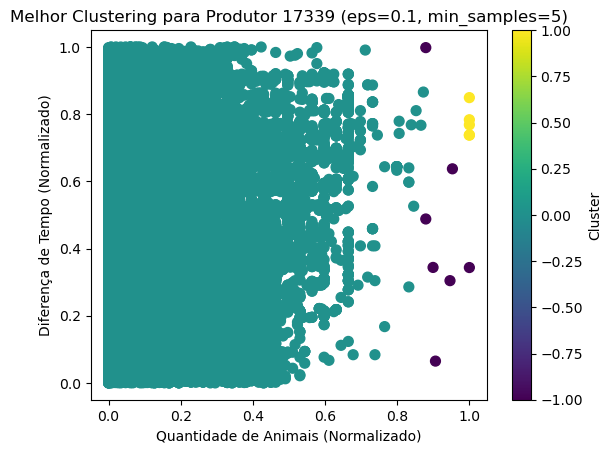

Data mais recente: 2025-01-08 17:30:10.503000


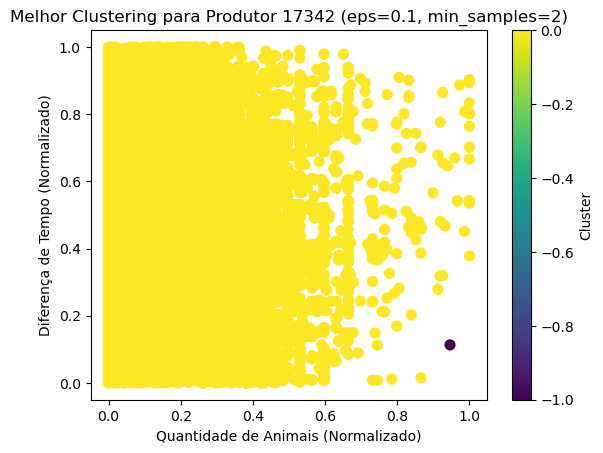

Data mais recente: 2025-01-07 16:07:05.881000


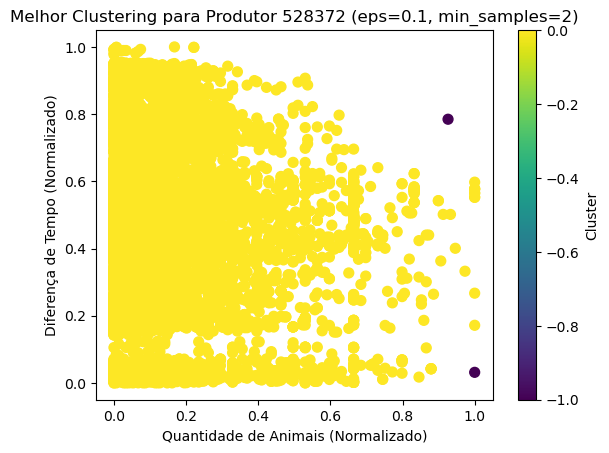

Data mais recente: 2025-01-07 11:39:42.334000


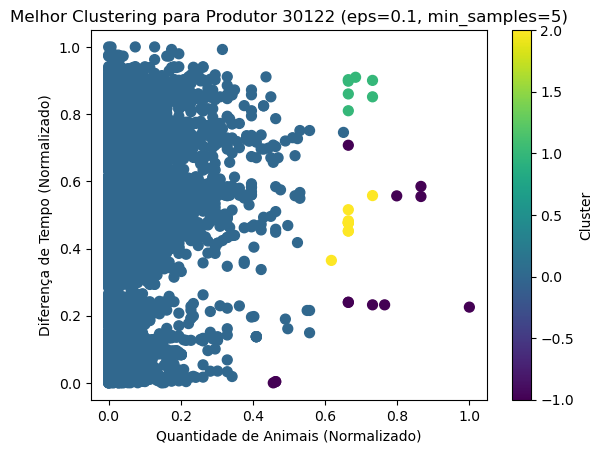

Data mais recente: 2025-01-06 10:35:48.124000


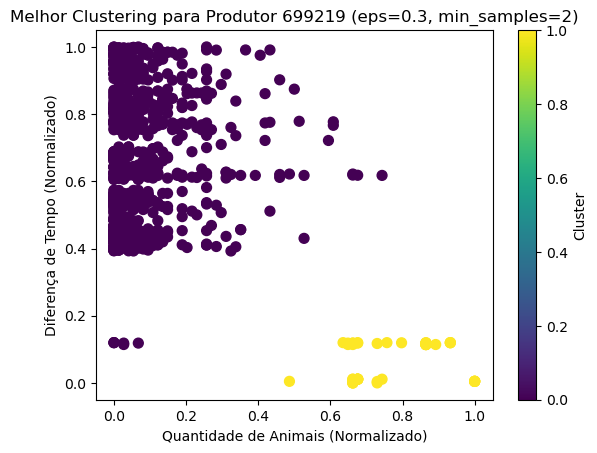

Data mais recente: 2024-12-20 14:09:37.242000


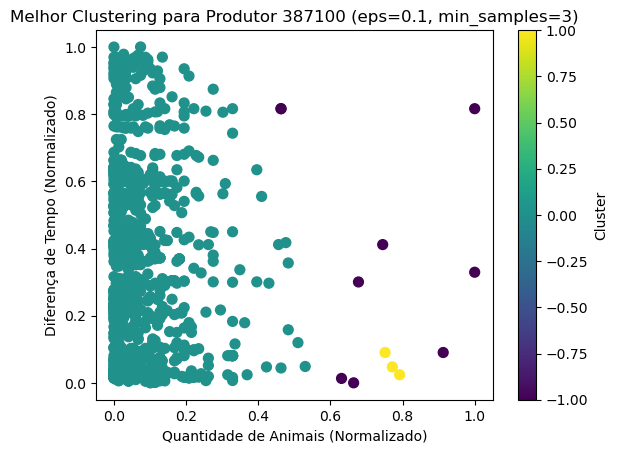

Data mais recente: 2024-12-03 10:33:40.127000


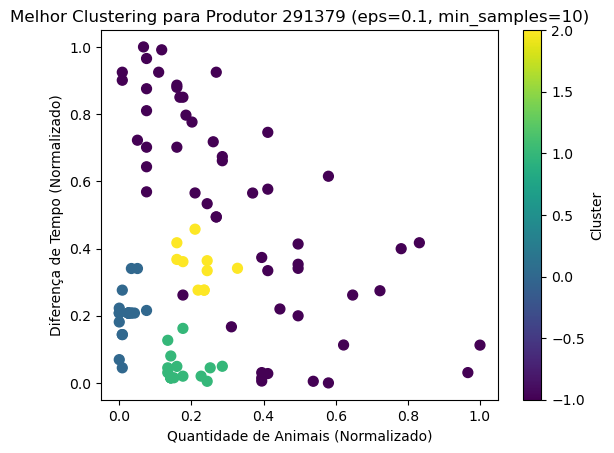

Data mais recente: 2022-12-17 22:33:46.646000


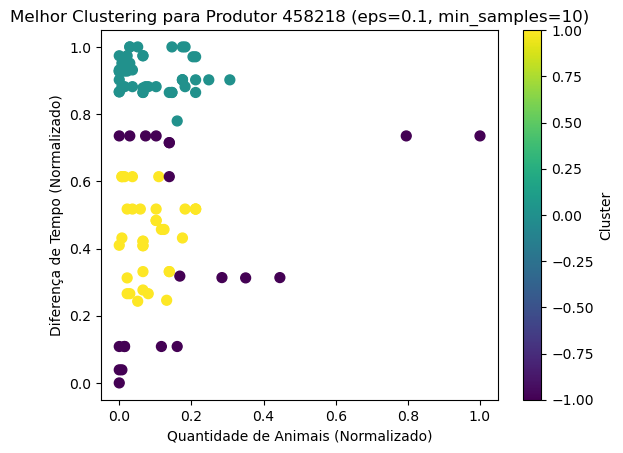

Data mais recente: 2023-06-28 10:55:17.469000


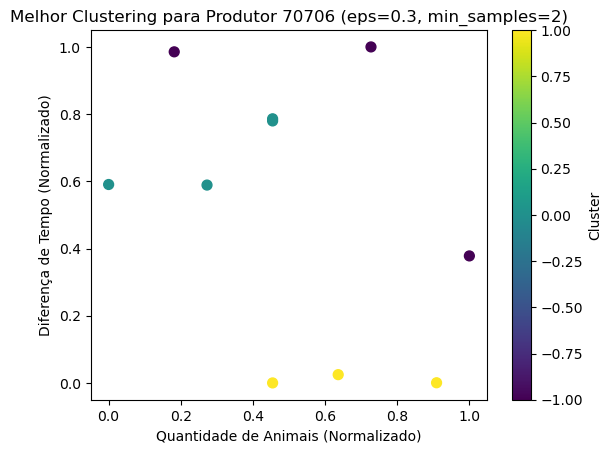

Data mais recente: 2020-01-06 13:48:12.447000


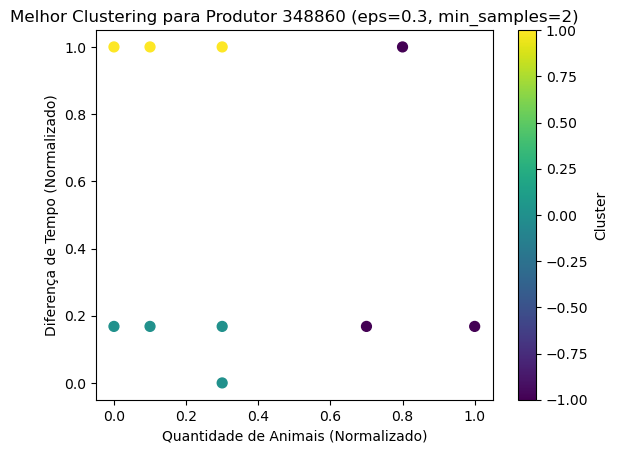

In [10]:
import pandas as pd
import numpy as np
import os
from sklearn.cluster import DBSCAN
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import silhouette_score
import matplotlib.pyplot as plt
import itertools

def count_records(combined_file):
    combined_df = pd.read_csv(combined_file)
    combined_df = combined_df.dropna(subset=["id_produtor_destino"])
    combined_df = combined_df.dropna(subset=["id_produtor_origem"])
    combined_df["id_produtor_destino"] = combined_df["id_produtor_destino"].apply(lambda x: str(int(float(x))) if isinstance(x, (int, float)) else str(x))
    combined_df["id_produtor_origem"] = combined_df["id_produtor_origem"].apply(lambda x: str(int(float(x))) if isinstance(x, (int, float)) else str(x))
    registros_por_produtor = combined_df["id_produtor_destino"].value_counts().reset_index()
    registros_por_produtor.columns = ["id_produtor_destino", "count"]
    if not os.path.exists("clusters"):
        os.makedirs("clusters")
    return registros_por_produtor, combined_df

def select_producers(registros_por_produtor):
    registros_por_produtor = registros_por_produtor.sort_values(by="count", ascending=False)
    top_2 = registros_por_produtor.head(2)
    group_10000 = registros_por_produtor.iloc[(registros_por_produtor["count"] - 10000).abs().argsort()[:2]]
    group_1000 = registros_por_produtor.iloc[(registros_por_produtor["count"] - 1000).abs().argsort()[:2]]
    group_100 = registros_por_produtor.iloc[(registros_por_produtor["count"] - 100).abs().argsort()[:2]]
    group_10 = registros_por_produtor.iloc[(registros_por_produtor["count"] - 10).abs().argsort()[:2]]
    selected_producers = pd.concat([top_2, group_10000, group_1000, group_100, group_10])
    selected_producers["id_produtor_destino"] = selected_producers["id_produtor_destino"].astype(str)
    return selected_producers

def preprocess_data(df, combined_df):
    combined_df["id_produtor_destino"] = combined_df["id_produtor_destino"].astype(str)
    filtered_df = combined_df[combined_df["id_produtor_destino"].isin(df["id_produtor_destino"])].copy()
    filtered_df["dt_emissao_gta"] = pd.to_datetime(filtered_df["dt_emissao_gta"])
    filtered_df.loc[:, "data_diff"] = (filtered_df["dt_emissao_gta"].max() - filtered_df["dt_emissao_gta"]).dt.total_seconds()
    max_date = filtered_df["dt_emissao_gta"].max()
    print(f"Data mais recente: {max_date}")
    scaler = MinMaxScaler()
    normalized_data = scaler.fit_transform(filtered_df[["qt_animais", "data_diff"]])
    filtered_df.loc[:, "qt_animais_norm"] = normalized_data[:, 0]
    filtered_df.loc[:, "data_diff_norm"] = normalized_data[:, 1]
    return filtered_df

def cluster_producers(df, eps=0.3, min_samples=2):
    features = df[["qt_animais_norm", "data_diff_norm"]]
    dbscan = DBSCAN(eps=eps, min_samples=min_samples, metric="euclidean")
    clusters = dbscan.fit_predict(features)
    df.loc[:, "cluster"] = clusters
    return df

def plot_clusters(df, title):
    plt.scatter(df["qt_animais_norm"], df["data_diff_norm"], c=df["cluster"], cmap="viridis", s=50)
    plt.colorbar(label="Cluster")
    plt.xlabel("Quantidade de Animais (Normalizado)")
    plt.ylabel("Diferença de Tempo (Normalizado)")
    plt.title(title)
    plt.show()

def save_producer_data(df, producer_id, file_prefix):
    producer_data = df[df["id_produtor_destino"] == str(producer_id)]
    producer_data.to_csv(f"{file_prefix}_produtor_{producer_id}.csv", sep=";", index=False)

def save_possible_frauds(possible_frauds, file_name):
    fraud_cases = []
    for case in possible_frauds:
        eps = case["eps"]
        min_samples = case["min_samples"]
        outliers = case["outliers"]
        outliers["eps"] = eps
        outliers["min_samples"] = min_samples
        fraud_cases.append(outliers)
    if fraud_cases:
        fraud_data = pd.concat(fraud_cases, ignore_index=True)
        fraud_data.to_csv(file_name, sep=";", index=False)

def grid_search_clustering(df, eps_values, min_samples_values):
    results = []
    possible_frauds = []
    for eps, min_samples in itertools.product(eps_values, min_samples_values):
        features = df[["qt_animais_norm", "data_diff_norm"]].values
        dbscan = DBSCAN(eps=eps, min_samples=min_samples, metric="euclidean")
        clusters = dbscan.fit_predict(features)
        df.loc[:, "cluster"] = clusters
        outliers = df[df["cluster"] == -1]
        if not outliers.empty:
            possible_frauds.append({
                "eps": eps,
                "min_samples": min_samples,
                "outliers": outliers.copy()
            })
        n_clusters = len(set(clusters)) - (1 if -1 in clusters else 0)
        if n_clusters > 1:
            valid_mask = clusters != -1
            score = silhouette_score(features[valid_mask], clusters[valid_mask])
        else:
            score = -1
        results.append({
            "eps": eps,
            "min_samples": min_samples,
            "silhouette_score": score,
            "n_clusters": n_clusters,
            "clustered_data": df.copy()
        })
    return results, possible_frauds

combined_file = "bd/dados_combinados.csv"
registros_por_produtor, combined_df = count_records(combined_file)
selected_producers = select_producers(registros_por_produtor)

eps_values = [0.1, 0.3, 0.5, 0.7, 0.9]
min_samples_values = [2, 3, 5, 10]

all_grid_search_results = []
all_possible_frauds = []

for _, producer in selected_producers.iterrows():
    producer_df = pd.DataFrame([producer])
    processed_data = preprocess_data(producer_df, combined_df)
    grid_results, possible_frauds = grid_search_clustering(processed_data, eps_values, min_samples_values)
    all_grid_search_results.append({
        "producer_id": producer["id_produtor_destino"],
        "results": grid_results
    })
    all_possible_frauds.extend(possible_frauds)
    best_result = max(grid_results, key=lambda x: x["silhouette_score"])
    best_clusters = best_result["clustered_data"]
    plot_clusters(best_clusters, f"Melhor Clustering para Produtor {producer['id_produtor_destino']} (eps={best_result['eps']}, min_samples={best_result['min_samples']})")
    best_clusters.to_csv(f"clusters/best_clusters_{producer['id_produtor_destino']}.csv", sep=";", index=False)

final_results = []
for group in all_grid_search_results:
    for result in group["results"]:
        final_results.append({
            "producer_id": group["producer_id"],
            "eps": result["eps"],
            "min_samples": result["min_samples"],
            "silhouette_score": result["silhouette_score"],
            "n_clusters": result["n_clusters"]
        })
results_df = pd.DataFrame(final_results)
results_df.to_csv("clusters/grid_search_results.csv", sep=";", index=False)

save_possible_frauds(all_possible_frauds, "clusters/possible_frauds.csv")